In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv('./laptops_10.csv')
df.head()

,Company,Product,TypeName,Inches,Cpu,Ram,Gpu,OpSys,Weight,Price_euros,Cpu_Company,Memory_Amount,Memory_Type
0,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 2.3GHz,8GB,Intel Iris Plus Graphics 640,macOS,1.37,1339.69,Intel,128,SSD
1,Apple,Macbook Air,Ultrabook,13.3,Intel Core i5 1.8GHz,8GB,Intel HD Graphics 6000,macOS,1.34,898.94,Intel,128,FlashStorage
2,HP,250 G6,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8GB,Intel HD Graphics 620,No OS,1.86,575.00,Intel,256,SSD
3,Apple,MacBook Pro,Ultrabook,15.4,Intel Core i7 2.7GHz,16GB,AMD Radeon Pro 455,macOS,1.83,2537.45,Intel,512,SSD
4,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 3.1GHz,8GB,Intel Iris Plus Graphics 650,macOS,1.37,1803.60,Intel,256,SSD


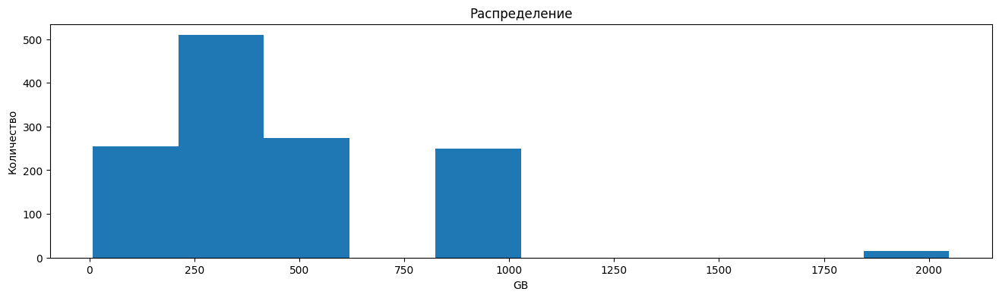

In [5]:
plt.figure(figsize=(16, 4))


plt.hist(df['Memory_Amount'])
plt.title('Распределение')
plt.xlabel('GB')
plt.ylabel('Количество');

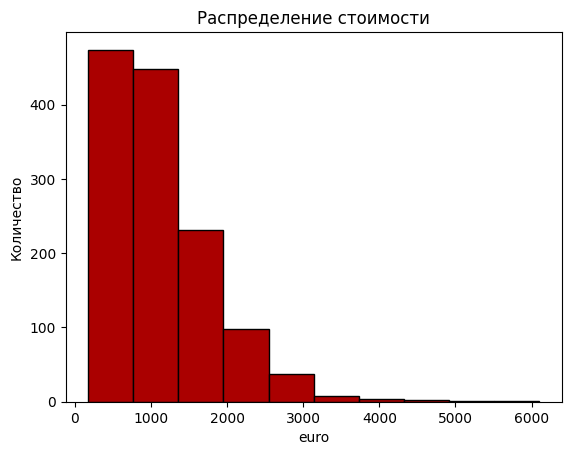

In [10]:
# df2 = pd.read_csv('https://drive.google.com/file/d/1MpAdHAl727fO3oW32NO4FpSRhUBUfjfS')
# df2.head()

plt.hist(df['Price_euros'], color='#AA0000', edgecolor='black')
plt.title('Распределение стоимости')
plt.xlabel('euro')
plt.ylabel('Количество');

1.3 Изучите вес ноутбуков с помощью matplotlib

Постройте график
Назовите график
Сделайте именование оси x и оси y
Сделайте выводы

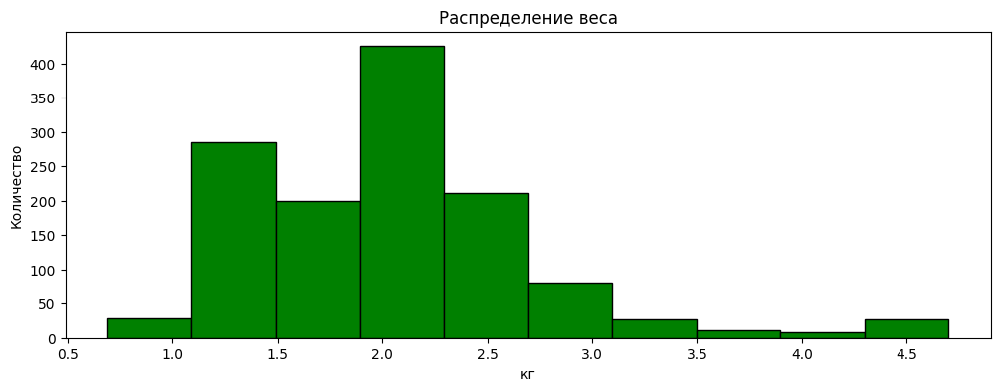

In [18]:
# df.info()
plt.figure(figsize=(12, 4))
plt.hist(df['Weight'], color='green', edgecolor='black')
plt.title('Распределение веса')
plt.xlabel('кг')
plt.ylabel('Количество');

In [21]:
data = df['Memory_Type'].value_counts()
data

Memory_Type
SSD             641
HDD             576
FlashStorage     74
Hybrid           12
Name: count, dtype: int64

In [23]:
names = data.index
values = data.values
print(names, values)

Index(['SSD', 'HDD', 'FlashStorage', 'Hybrid'], dtype='object', name='Memory_Type') [641 576  74  12]


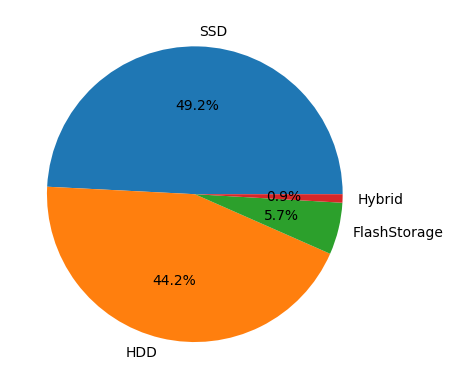

In [27]:
plt.pie(values, autopct='%.1f%%', labels=names);

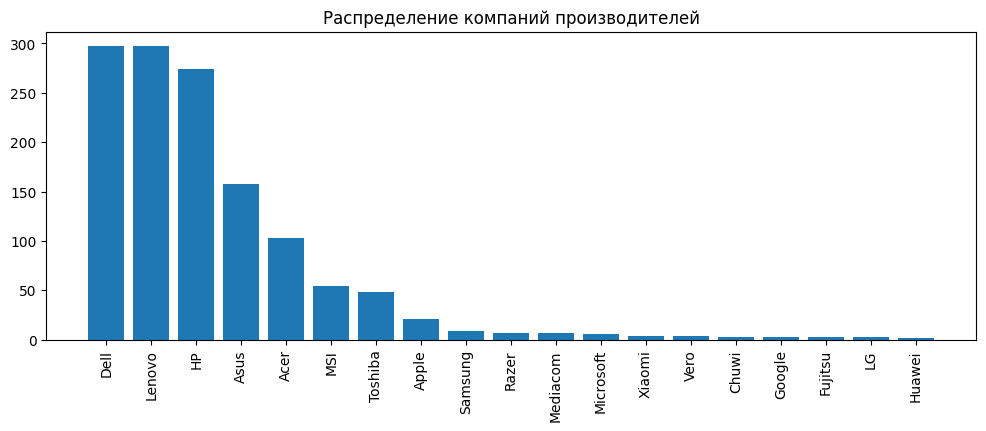

In [35]:
data = df['Company'].value_counts()
names = data.index
values = data.values
# print(names, values)
plt.figure(figsize=(12, 4))
plt.bar(names, values)
plt.title('Распределение компаний производителей')
plt.xticks(rotation=90);

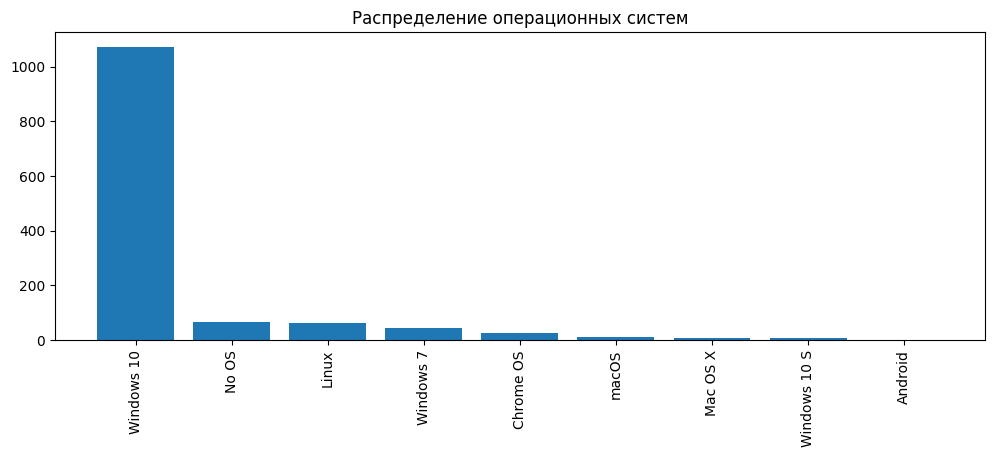

In [39]:
data = df['OpSys'].value_counts()
names = data.index
values = data.values
# print(names, values)
plt.figure(figsize=(12, 4))
plt.bar(names, values)
plt.title('Распределение операционных систем')
plt.xticks(rotation=90);

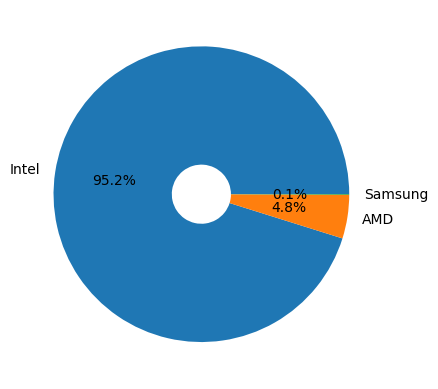

In [45]:
data = df['Cpu_Company'].value_counts()
names = data.index
values = data.values
fig, ax = plt.subplots()
ax.pie(values, labels=names, autopct='%.1f%%', wedgeprops=dict(width=0.8));

In [48]:
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'])

data = data.drop(columns=['Samsung']).reset_index()
data

Cpu_Company,Company,AMD,Intel
0,Acer,10,93
1,Apple,0,21
2,Asus,11,147
3,Chuwi,0,3
4,Dell,0,297
5,Fujitsu,0,3
6,Google,0,3
7,HP,25,249
8,Huawei,0,2
9,LG,0,3


[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]


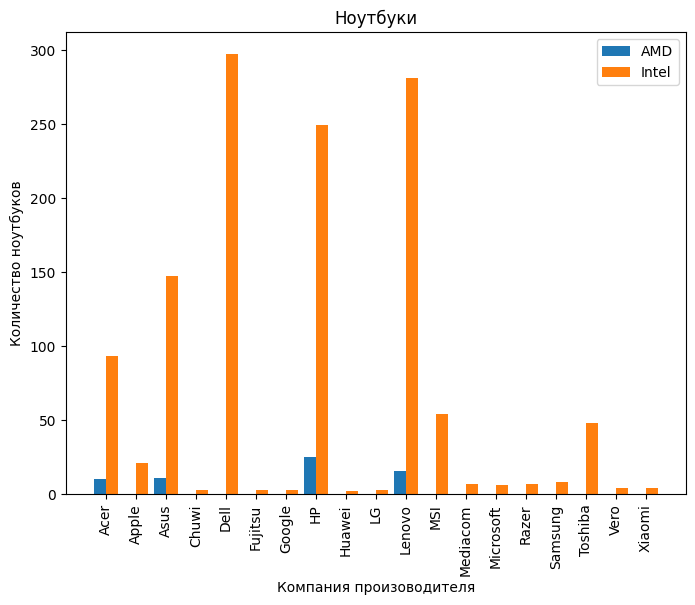

In [50]:
plt.figure(figsize=(8, 6))
n_ticks = np.arange(len(data['AMD']))
print(n_ticks)
offset = 0.2
w = 0.4 

plt.bar(n_ticks - offset, data['AMD'], width=w)
plt.bar(n_ticks + offset, data['Intel'], width=w)
plt.title('Ноутбуки')
plt.xlabel('Компания произоводителя')
plt.ylabel('Количество ноутбуков')
plt.legend(['AMD', 'Intel'])
plt.xticks(n_ticks, data['Company'], rotation=90);

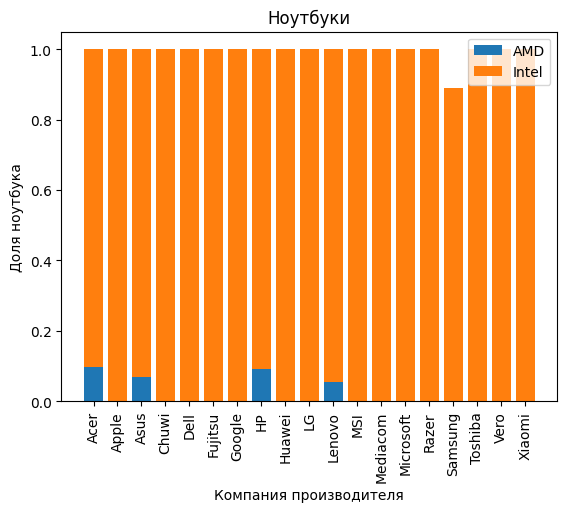

In [51]:
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'], normalize='index')
data = data.drop(columns=['Samsung']).reset_index()
plt.bar(data['Company'], data['AMD'])
plt.bar(data['Company'], data['Intel'], bottom=data['AMD'])

plt.title('Ноутбуки')
plt.xlabel('Компания производителя')
plt.ylabel('Доля ноутбука')
plt.legend(['AMD', 'Intel'])
plt.xticks(rotation=90);

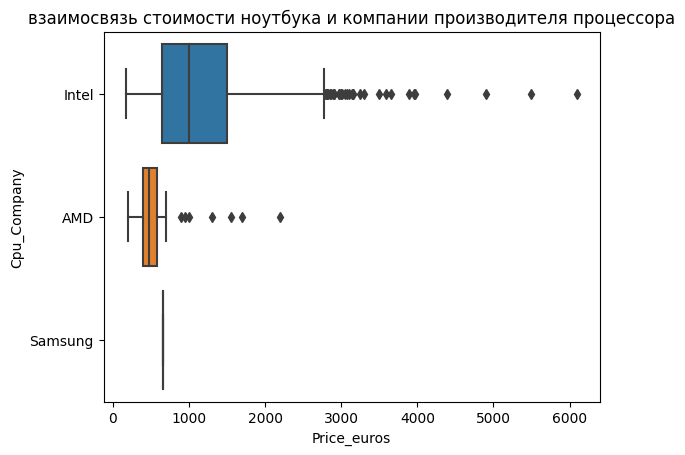

In [58]:
df = pd.read_csv('./laptops_10.csv')
sns.boxplot(x = df['Price_euros'], y = df['Cpu_Company'])

plt.title('взаимосвязь стоимости ноутбука и компании производителя процессора')
plt.xlabel('Price_euros')
plt.ylabel('Cpu_Company');


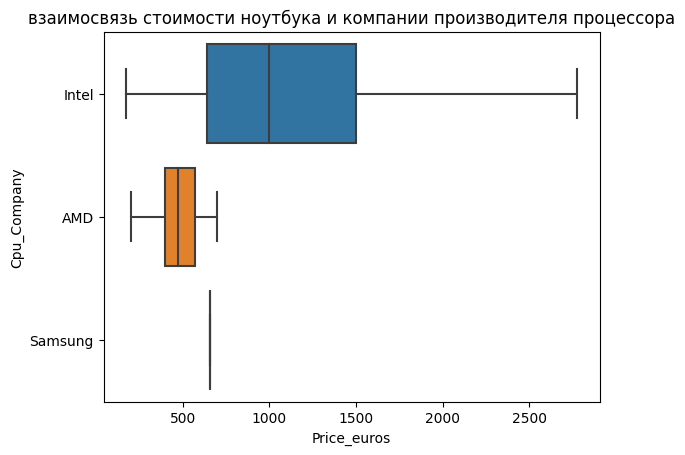

In [59]:
sns.boxplot(x=df['Price_euros'], y=df['Cpu_Company'], showfliers=False)
plt.title('взаимосвязь стоимости ноутбука и компании производителя процессора')
plt.xlabel('Price_euros')
plt.ylabel('Cpu_Company');

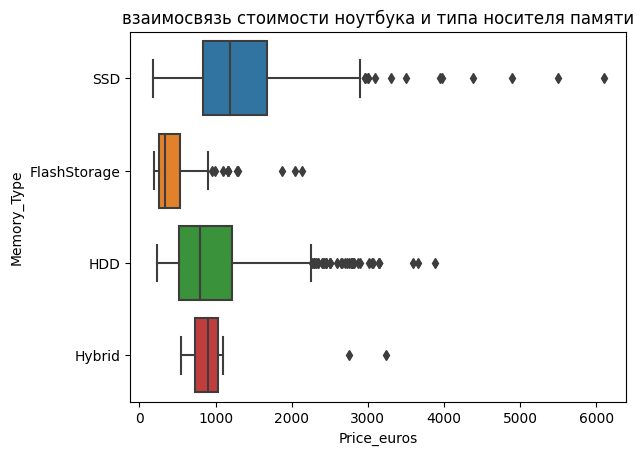

In [61]:
sns.boxplot(x=df['Price_euros'], y=df['Memory_Type'])

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Memory_Type');

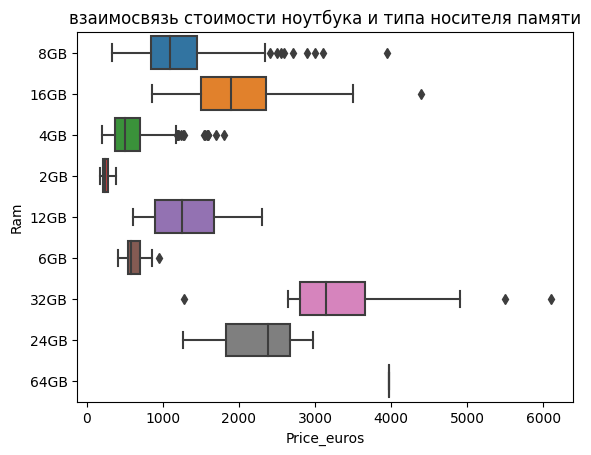

In [64]:
sns.boxplot(x=df['Price_euros'], y=df['Ram'])

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Ram');

In [ ]:
df2 = 
sns.boxplot(x=df['Price_euros'], y=df['Ram'])

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Ram');


In [67]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix < 0.3)] = 0
corr_matrix



ValueError: could not convert string to float: 'Apple'

In [68]:
sns.heatmap(corr_matrix, annot=True, linewidths=0.5, cmap='coolwarm');

NameError: name 'corr_matrix' is not defined

In [80]:
df = pd.read_csv('./kc_house_data.csv' , sep=',')
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix < 0.3)] = 0
corr_matrix
# sns.heatmap(corr_matrix, annot=True, linewidths=0.5, cmap='coolwarm');
# sns.heatmap(corr_matrix, annot=True, linewidths=0.5, cmap='coolwarm');

ValueError: could not convert string to float: '20141013T000000'

In [74]:
import folium

this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(location=[point.lat, point.long], radius=2, popup=[point.price, point.floors]).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map

In [81]:
df = pd.read_csv('./kc_house_data.csv' , sep=',')
corr_matrix = df.corr()

ValueError: could not convert string to float: '20141013T000000'